In [1]:
# black code formatting
%load_ext lab_black

# Image Processing Workshop

## Import

In [46]:
# -*- coding: UTF-8 -*-
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

import numpy as np
import matplotlib.pyplot as plt

import os
import pickle

from glob import glob
from tqdm import tqdm
import math

import cv2

"""GPU-Setting"""
# os.environ["CUDA_VISIBLE_DEVICES"] = "0,1"
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices("GPU")))

gpus = tf.config.experimental.list_physical_devices("GPU")
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices("GPU")
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

Num GPUs Available:  1
1 Physical GPUs, 1 Logical GPUs


In [3]:
# my global functions

class_names = [
    "gaensebluemchen",
    "hasengloeckchen",
    "krokus",
    "loewenzahn",
    "narzisse",
    "schneegloeckchen",
    "sonnenblume",
]


def get_class_from_id(label_idx):
    switcher = {
        0: class_names[0],
        1: class_names[1],
        2: class_names[2],
        3: class_names[3],
        4: class_names[4],
        5: class_names[5],
        6: class_names[6],
    }
    return switcher.get(label_idx)


def check_data(my_data, tag="my_data"):
    print(
        f"tag Shape=%s, min=%.3f, max=%.3f"
        % (my_data.shape, my_data.min(), my_data.max())
    )

# Data Processing

In [31]:
# params
num_classes = 7

# model
num_filter = 32
dropout = 0.3

# training
img_size = (512, 512)
batch_size = 128
epochs = int(1e9)

In [32]:
# get data paths

img_paths = glob("./data/7flowers_imgs/*.jpg")
img_paths.sort()

img_paths[:3]

['./data/7flowers_imgs/gaensebluemchen_01.jpg',
 './data/7flowers_imgs/gaensebluemchen_02.jpg',
 './data/7flowers_imgs/gaensebluemchen_03.jpg']

In [33]:
# load data

img_list = []
label_list = []

for img_path_tmp in tqdm(img_paths):

    ### IMAGE ###
    img_tmp = plt.imread(img_path_tmp)  # load image
    img_tmp = cv2.resize(src=img_tmp, dsize=img_size)
    assert img_tmp.shape[-1] == 3  # check for grayscale or anomalies
    img_list.append(img_tmp)

    ### LABEL ###
    label_tmp = img_path_tmp.split("/")[-1].split("_")[0]  # get label
    label_list.append(label_tmp)

imgs = np.asarray(img_list)
labels = np.asarray(label_list)
labels = np.expand_dims(labels, axis=-1)

labels[:3]

100%|██████████| 640/640 [00:03<00:00, 187.48it/s]


array([['gaensebluemchen'],
       ['gaensebluemchen'],
       ['gaensebluemchen']], dtype='<U16')

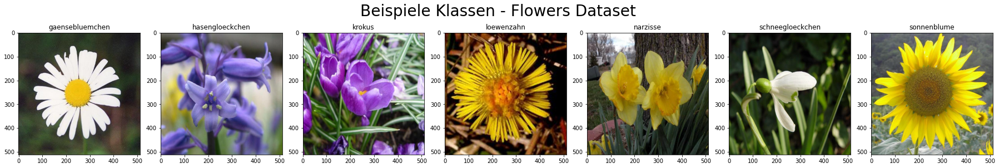

In [34]:
img_sample_list = []
label_sample_list = []

for class_tmp in class_names:
    for img_tmp, label_tmp in zip(imgs, labels):
        if label_tmp == class_tmp:
            label_sample_list.append(class_tmp)
            img_sample_list.append(img_tmp)
            break

# plot
plt.close()
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(1, 7, figsize=(25, 4))
fig.suptitle("Beispiele Klassen - Flowers Dataset", fontsize=28)
ax1.imshow(img_sample_list[0], "gray")
ax1.title.set_text(f"\n{label_sample_list[0]}")
ax2.imshow(img_sample_list[1], "gray")
ax2.title.set_text(f"\n{label_sample_list[1]}")
ax3.imshow(img_sample_list[2], "gray")
ax3.title.set_text(f"\n{label_sample_list[2]}")
ax4.imshow(img_sample_list[3], "gray")
ax4.title.set_text(f"\n{label_sample_list[3]}")
ax5.imshow(img_sample_list[4], "gray")
ax5.title.set_text(f"\n{label_sample_list[4]}")
ax6.imshow(img_sample_list[5], "gray")
ax6.title.set_text(f"\n{label_sample_list[5]}")
ax7.imshow(img_sample_list[6], "gray")
ax7.title.set_text(f"\n{label_sample_list[6]}")
plt.tight_layout()
plt.show()

In [35]:
# data check
print("imgs Shape=%s, min=%.3f, max=%.3f" % (imgs.shape, imgs.min(), imgs.max()))
print(f"labels Shape={labels.shape}")

imgs Shape=(640, 512, 512, 3), min=0.000, max=255.000
labels Shape=(640, 1)


In [36]:
# one-hot-encopding labels
from sklearn.preprocessing import OneHotEncoder

my_onehotencoder = OneHotEncoder()
labels = my_onehotencoder.fit_transform(labels).toarray()

for label_tmp in labels:
    # print(label_tmp)
    pass

In [37]:
# normalization
imgs = imgs / 255

In [38]:
# split dataset

# shuffle images and image targets, with same seed so both are shuffled the same way
rnd_int = np.random.randint(123)
np.random.seed(rnd_int)
np.random.shuffle(imgs)
np.random.seed(rnd_int)
np.random.shuffle(labels)

# add first 80% of shuffled and concatenated image data to train data
imgs_train = imgs[: int(0.8 * len(imgs))]
labels_train = labels[: int(0.8 * len(labels))]

# add last 20% of shuffled and concatenated image data to vali data
imgs_val = imgs[int(0.8 * len(imgs)) :]
labels_val = labels[int(0.8 * len(labels)) :]

In [39]:
# data check
check_data(imgs_train, "imgs_train")
check_data(labels_train, "labels_train")
check_data(imgs_val, "imgs_val")
check_data(labels_val, "labels_val")

tag Shape=(512, 512, 512, 3), min=0.000, max=1.000
tag Shape=(512, 7), min=0.000, max=1.000
tag Shape=(128, 512, 512, 3), min=0.000, max=1.000
tag Shape=(128, 7), min=0.000, max=1.000


In [40]:
# augmentierung

from tensorflow.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
    width_shift_range=40,
    height_shift_range=40,
    shear_range=16.0,
    rotation_range=180,
    brightness_range=[0.5, 2],
    zoom_range=[0.4, 1.6],
    rescale=1.0 / 255.0,  # normalization
    fill_mode="nearest",
)
aug_iterator = datagen.flow(
    (imgs_train * 255).astype("uint8"),
    (labels_train).astype("uint8"),
    batch_size=batch_size,
)  # 'dis'-normalization for ImageDataGenerator processing

samples_per_epoche = imgs_train.shape[0] // batch_size
samples_per_epoche

4

class: hasengloeckchen


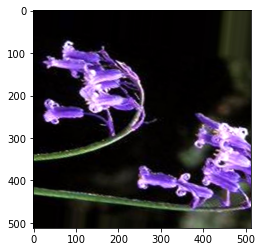

In [41]:
batch = next(aug_iterator)

idx = np.random.randint(len(batch[0]))
img_tmp = batch[0][idx]
class_tmp = batch[1][idx].argmax()
print(f"class: {get_class_from_id(class_tmp)}")

plt.close()
plt.figure(figsize=(4, 4), facecolor="w")
plt.imshow((img_tmp * 255).astype("uint8"), "gray")
plt.show()

In [42]:
# data check
sample_imgs_train, sample_labels_train = next(aug_iterator)
sample_img_val, sample_labels_val = (imgs_val, labels_val)

check_data(sample_imgs_train, "sample_imgs_train")
check_data(sample_labels_train, "sample_labels_train")
check_data(sample_img_val, "sample_img_val")
check_data(sample_labels_val, "sample_labels_val")

tag Shape=(128, 512, 512, 3), min=0.000, max=1.000
tag Shape=(128, 7), min=0.000, max=1.000
tag Shape=(128, 512, 512, 3), min=0.000, max=1.000
tag Shape=(128, 7), min=0.000, max=1.000


## Visio

### train

tag Shape=(512, 128, 128, 3), min=0.000, max=1.000
tag Shape=(512, 7), min=0.000, max=1.000


<Figure size 432x288 with 0 Axes>

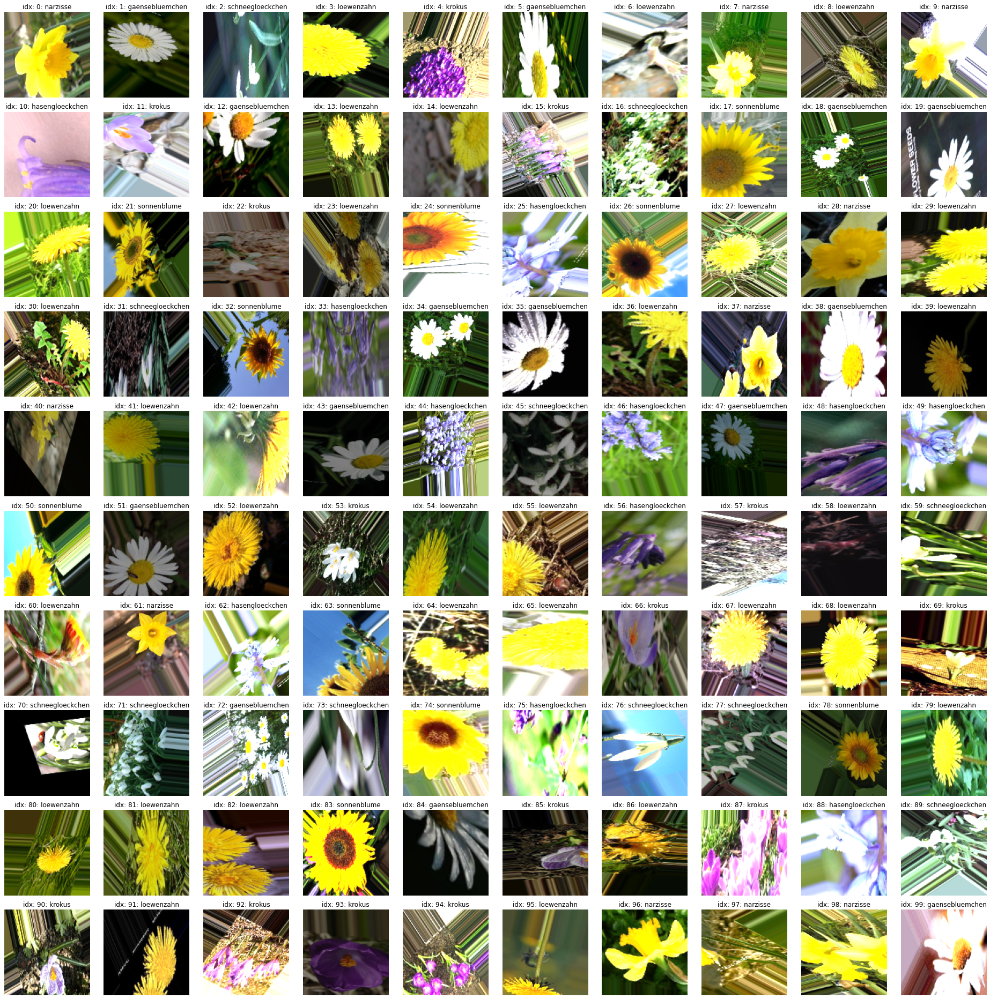

In [16]:
img_batch_tmp_list = []
labels_batch_tmp_list = []


for _ in range(len(imgs_train) // batch_size):
    img_batch_tmp, labels_batch_tmp = next(aug_iterator)
    img_batch_tmp_list.append(img_batch_tmp)
    labels_batch_tmp_list.append(labels_batch_tmp)


img_batch_tmp = np.asarray(img_batch_tmp_list).reshape(
    (-1, img_size[0], img_size[1], 3)
)
labels_batch_tmp = np.asarray(labels_batch_tmp_list).reshape((-1, num_classes))


check_data(img_batch_tmp, "img_batch_tmp")
check_data(labels_batch_tmp, "labels_batch_tmp")

# shuffle images and image targets, with same seed so both are shuffled the same way
np.random.seed(42)
np.random.shuffle(img_batch_tmp)
np.random.seed(42)
np.random.shuffle(labels_batch_tmp)

plt.close()
plt.clf()
fig = plt.figure(figsize=(26, 26))
for idx in range(100):
    class_tmp = get_class_from_id(np.argmax(labels_batch_tmp[idx]))
    ax1 = plt.subplot(10, 10, idx + 1)
    plt.title(f"idx: {idx}: {class_tmp}")
    plt.imshow(img_batch_tmp[idx], "gray")
    ax1.axis("off")
plt.tight_layout()
plt.show()

### val

<Figure size 432x288 with 0 Axes>

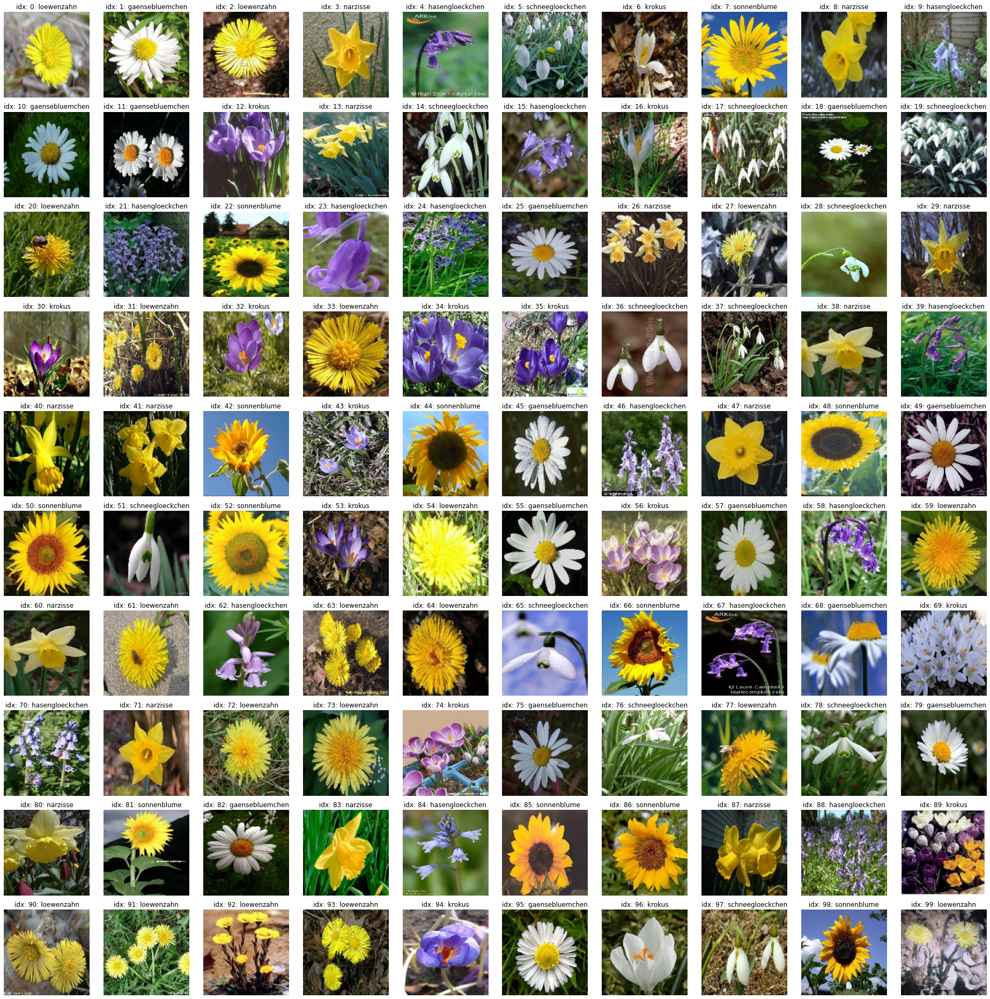

In [17]:
# shuffle images and image targets, with same seed so both are shuffled the same way
np.random.seed(42)
np.random.shuffle(imgs_val)
np.random.seed(42)
np.random.shuffle(labels_val)

plt.close()
plt.clf()
fig = plt.figure(figsize=(26, 26))
for idx in range(100):
    class_tmp = get_class_from_id(np.argmax(labels_val[idx]))
    ax1 = plt.subplot(10, 10, idx + 1)
    plt.title(f"idx: {idx}: {class_tmp}")
    plt.imshow(imgs_val[idx], "gray")
    ax1.axis("off")
plt.tight_layout()
plt.show()

# Classic Image Processing

tag Shape=(512, 512, 3), min=0.000, max=1.000
sonnenblume


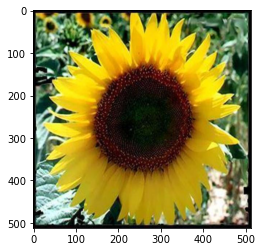

In [198]:
rnd_idx = np.random.randint(len(imgs_train))
# rnd_idx = 358
img = imgs_train[rnd_idx]

# data check
check_data(img, "sample_img")

print(get_class_from_id(labels_train[rnd_idx].argmax(axis=-1)))
# plot
plt.close()
plt.figure(figsize=(4, 4), facecolor="w")
plt.imshow((img * 255).astype("uint8"), "gray")
plt.show()

### Color Channels

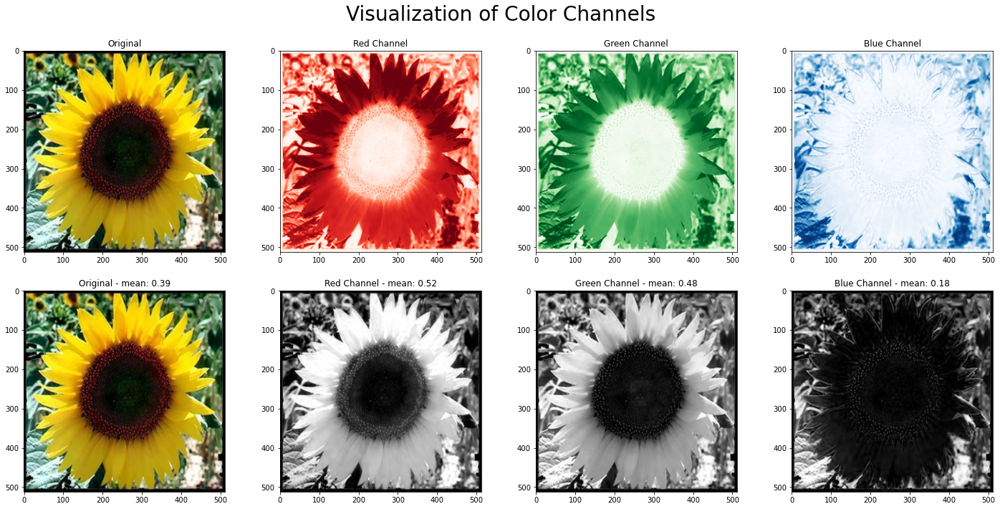

In [199]:
plt.close()
fig, ([ax11, ax12, ax13, ax14], [ax21, ax22, ax23, ax24]) = plt.subplots(
    2, 4, figsize=(20, 10)
)
fig.suptitle("Visualization of Color Channels", fontsize=28)
ax11.imshow(img[:, :, :], vmin=0, vmax=1)
ax11.title.set_text("\nOriginal")
ax12.imshow(img[:, :, 0], "Reds", vmin=0, vmax=1)
ax12.title.set_text("\nRed Channel")
ax13.imshow(img[:, :, 1], "Greens", vmin=0, vmax=1)
ax13.title.set_text("\nGreen Channel")
ax14.imshow(img[:, :, 2], "Blues", vmin=0, vmax=1)
ax14.title.set_text("\nBlue Channel")
ax21.imshow(img[:, :, :], vmin=0, vmax=1)
ax21.title.set_text(f"\nOriginal - mean: {round(img[:, :, :].mean(),2)}")
ax22.imshow(img[:, :, 0], "gray", vmin=0, vmax=1)
ax22.title.set_text(f"\nRed Channel - mean: {round(img[:, :, 0].mean(),2)}")
ax23.imshow(img[:, :, 1], "gray", vmin=0, vmax=1)
ax23.title.set_text(f"\nGreen Channel - mean: {round(img[:, :, 1].mean(),2)}")
ax24.imshow(img[:, :, 2], "gray", vmin=0, vmax=1)
ax24.title.set_text(f"\nBlue Channel - mean: {round(img[:, :, 2].mean(),2)}")
plt.tight_layout()
plt.show()

### Shapes - Edges

In [200]:
# Convert to graycsale
img_gray = cv2.cvtColor((img * 255).astype("uint8"), cv2.COLOR_BGR2GRAY)
# Blur the image for better edge detection
img_blur = cv2.GaussianBlur(img_gray, (3, 3), 0)

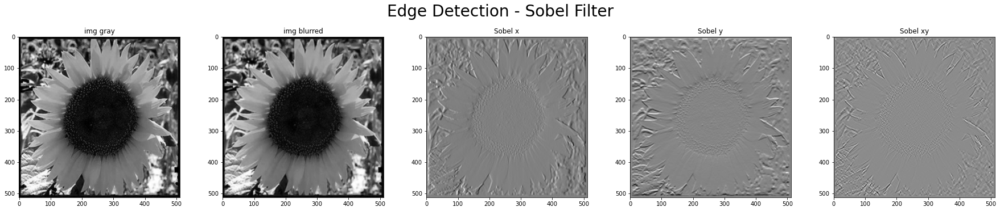

In [201]:
# Sobel Edge Detection
sobelx = cv2.Sobel(
    src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5
)  # Sobel Edge Detection on the X axis
sobely = cv2.Sobel(
    src=img_blur, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5
)  # Sobel Edge Detection on the Y axis
sobelxy = cv2.Sobel(
    src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5
)  # Combined X and Y Sobel Edge Detection

# plot
plt.close()
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(25, 5))
fig.suptitle("Edge Detection - Sobel Filter", fontsize=28)
ax1.imshow(img_gray, "gray")
ax1.title.set_text("\nimg gray")
ax2.imshow(img_blur, "gray")
ax2.title.set_text("\nimg blurred")
ax3.imshow(sobelx, "gray")
ax3.title.set_text("\nSobel x")
ax4.imshow(sobely, "gray")
ax4.title.set_text("\nSobel y")
ax5.imshow(sobelxy, "gray")
ax5.title.set_text("\nSobel xy")
plt.tight_layout()
plt.show()

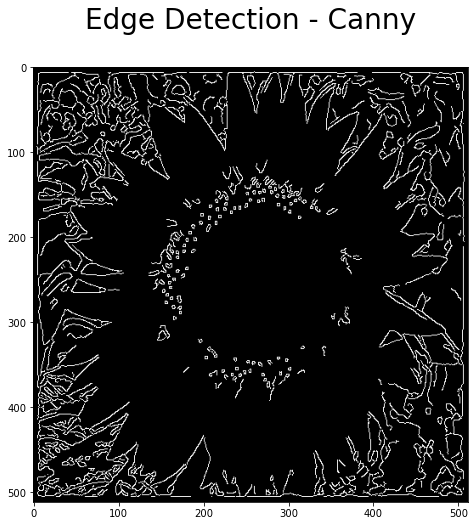

In [202]:
# Canny Edge Detection
edges = cv2.Canny(
    image=img_blur, threshold1=100, threshold2=200
)  # Canny Edge Detection

# plot
plt.close()
plt.figure(figsize=(8, 8), facecolor="w")
plt.imshow(edges, "gray")
plt.title("Edge Detection - Canny\n", fontsize=28)
plt.show()

### Shapes - Circles

tag Shape=(512, 512), min=0.000, max=255.000


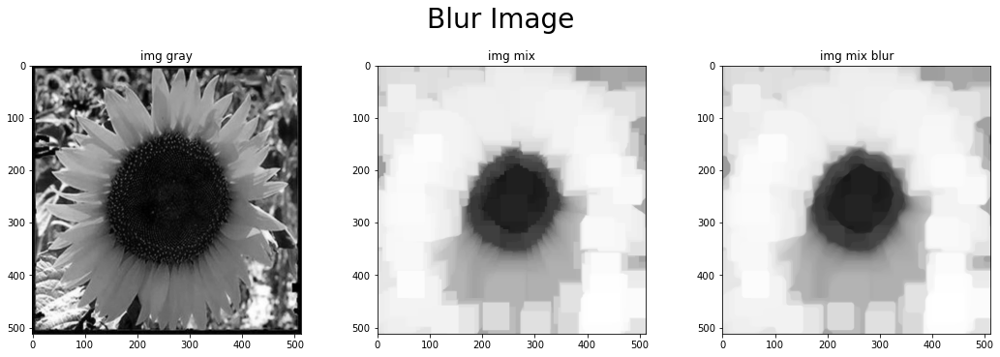

tag Shape=(512, 512), min=23.000, max=255.000


In [217]:
# Mixup Color Channel
img_mix = ((img[:, :, 0] + img[:, :, 1]) * 255 / 2).astype("uint8")
# ret, img_mix = cv2.threshold(img_mix, 127, 255, cv2.THRESH_BINARY)
# ret, img_mix_inv = cv2.threshold(img_mix, 127, 255, cv2.THRESH_BINARY_INV)

check_data(img_mix, "img_mix")


# dilation & erosion
kernel = np.ones((3, 3), np.uint8)

# The first parameter is the original image,
# kernel is the matrix with which image is
# convolved and third parameter is the number
# of iterations, which will determine how much
# you want to erode/dilate a given image.
for _ in range(24):
    img_mix = cv2.erode(img_mix, kernel, iterations=1)
    img_mix = cv2.dilate(img_mix, kernel, iterations=2)


# Blur the image for better circle detection
img_mix_blur = cv2.medianBlur(img_mix, 9)

# plot
plt.close()
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
fig.suptitle("Blur Image", fontsize=28)
ax1.imshow(img_gray, "gray", vmin=0, vmax=255)
ax1.title.set_text("\nimg gray")
ax2.imshow(img_mix, "gray", vmin=0, vmax=255)
ax2.title.set_text("\nimg mix")
ax3.imshow(img_mix_blur, "gray", vmin=0, vmax=255)
ax3.title.set_text("\nimg mix blur")
plt.tight_layout()
plt.show()

check_data(img_mix_blur, "img_mix_blur")

11 Circles Detected


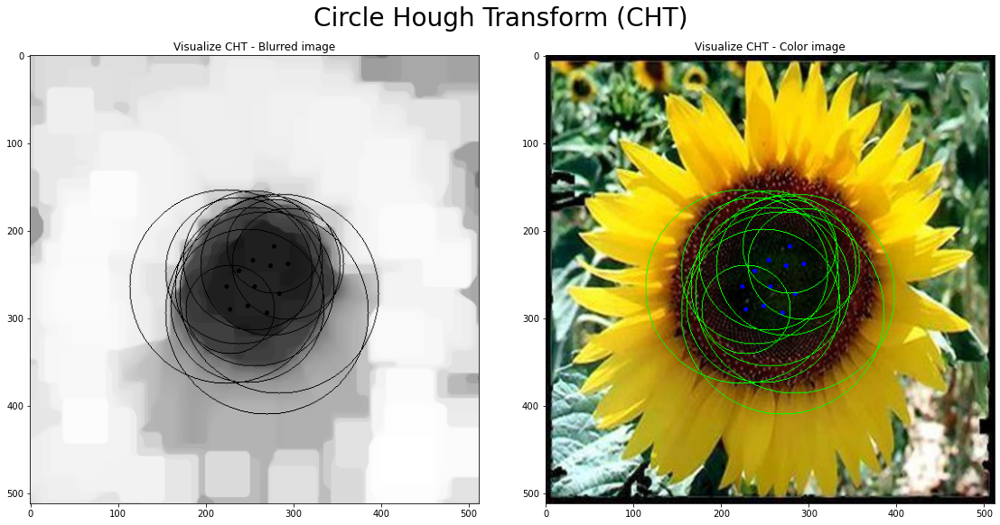

In [219]:
# Apply Hough transform on the blurred image.
minDist = 20
param1 = 50  # 500
param2 = 40  # 200 #smaller value-> more false circles
minRadius = 50
maxRadius = 0  # 10

detected_circles = cv2.HoughCircles(
    img_mix_blur,
    cv2.HOUGH_GRADIENT,
    1,
    minDist,
    param1=param1,
    param2=param2,
    minRadius=minRadius,
    maxRadius=maxRadius,
)


# Draw circles that are detected.
img_rgb_tmp = img.copy()
img_rgb_tmp = (img_rgb_tmp * 255).astype("uint8")  # data type range -> 255
img_mix_blur_tmp = img_mix_blur.copy()

if detected_circles is not None:
    print(f"{detected_circles.shape[1]} Circles Detected")
    # Convert the circle parameters a, b and r to integers.
    detected_circles = np.uint16(np.around(detected_circles))

    for pt in detected_circles[0, :]:
        a, b, r = pt[0], pt[1], pt[2]

        # Draw the circumference of the circle.
        cv2.circle(img_rgb_tmp, (a, b), r, (0, 255, 0), 1)
        cv2.circle(img_mix_blur_tmp, (a, b), r, (0, 255, 0), 1)

        # Draw a small circle (of radius 1) to show the center.
        cv2.circle(img_rgb_tmp, (a, b), 1, (0, 0, 255), 2)
        cv2.circle(img_mix_blur_tmp, (a, b), 1, (0, 0, 255), 2)
else:
    print(f"0 Circles Detected")
# plot
plt.close()
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
fig.suptitle("Circle Hough Transform (CHT)", fontsize=28)
ax1.imshow(img_mix_blur_tmp, "gray")
ax1.title.set_text("\nVisualize CHT - Blurred image")
ax2.imshow(img_rgb_tmp, "gray")
ax2.title.set_text("\nVisualize CHT - Color image")
plt.tight_layout()
plt.show()

# Programming

An dieser Stelle können die Teilnehmer versuchen mit eigenen Ideen die Klassifikation der Blumenbildern auszuprobieren.

### Mittels klassische Bildverarbeitung

In [226]:
"""useful functions"""

# get mean of red color channel
def get_color_mean_red(img):
    return img[:, :, 0].mean()


# get mean of green color channel
def get_color_mean_green(img):
    return img[:, :, 1].mean()


# get mean of blue color channel
def get_color_mean_blue(img):
    return img[:, :, 2].mean()


# get mean of blue color channel
def get_num_circles(img):
    # Mixup Color Channel
    img_mix = ((img[:, :, 0] + img[:, :, 1]) * 255 / 2).astype("uint8")
    # dilation & erosion
    kernel = np.ones((3, 3), np.uint8)
    for _ in range(24):
        img_mix = cv2.erode(img_mix, kernel, iterations=1)
        img_mix = cv2.dilate(img_mix, kernel, iterations=2)
    # Blur the image for better circle detection
    img_mix_blur = cv2.medianBlur(img_mix, 9)
    # Apply Hough transform on the blurred image.
    detected_circles = cv2.HoughCircles(
        img_mix_blur,
        cv2.HOUGH_GRADIENT,
        1,
        20,
        param1=50,
        param2=40,
        minRadius=50,
        maxRadius=0,
    )
    return detected_circles.shape[1]

In [227]:
# example
mean_yellow = get_color_mean_red(img) + get_color_mean_green(img)
num_circles = get_num_circles(img)

mean_yellow, num_circles

(0.9942249223297719, 11)

In [228]:
# loop for predicting whole val dataset

preds_val_list = []

for img_val_tmp in imgs_val:
    # TODO: Regeln zur Klassifikation überlegen
    preds_val_list.append(np.random.randint(7))  # FIXME: just for getting random values
    # ...

preds_val = np.asarray(preds_val_list)

### Mittels ML Modelen

In [43]:
# keras import
from keras.optimizers import Adam
from keras.datasets import cifar10
from keras.models import Sequential
from keras.layers import Dropout, Dense, Flatten
from keras.layers.convolutional import Conv2D, MaxPooling2D

In [44]:
# params

# model
input_shape = imgs_train[0].shape
num_filter = 32
kernel_size = 3
dropout = 0.4

# training
epochs = int(1e9)
lr = 1e-3

# keras sequential model
model = Sequential(name="flowers_cnn")
# conv2D-layer
model.add(
    Conv2D(
        num_filter, (3, 3), input_shape=input_shape, padding="same", activation="relu"
    )
)
model.add(Dropout(dropout))
model.add(
    Conv2D(num_filter, (kernel_size, kernel_size), activation="relu", padding="same")
)
model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(Dropout(dropout))
model.add(
    Conv2D(num_filter, (kernel_size, kernel_size), activation="relu", padding="same")
)
model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(
    Conv2D(num_filter, (kernel_size, kernel_size), activation="relu", padding="same")
)
model.add(MaxPooling2D(pool_size=(4, 4)))
model.add(
    Conv2D(num_filter, (kernel_size, kernel_size), activation="relu", padding="same")
)
model.add(MaxPooling2D(pool_size=(4, 4)))

# dense-layer
model.add(Flatten())
model.add(Dense(256, activation="relu"))
model.add(Dropout(dropout))
model.add(Dense(num_classes, activation="softmax"))

# compile model
opt = Adam(learning_rate=lr)

model.compile(
    loss="categorical_crossentropy", optimizer=opt, metrics=["accuracy"],
)

model.summary()

Model: "flowers_cnn"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 512, 512, 32)      896       
_________________________________________________________________
dropout_3 (Dropout)          (None, 512, 512, 32)      0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 512, 512, 32)      9248      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 128, 128, 32)      9248      
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 32, 32, 32)        

### Training

In [47]:
# with augmentation

# params
verbose = 1

es = EarlyStopping(monitor="val_loss", mode="min", verbose=verbose, patience=50)
cp = ModelCheckpoint(
    "./model/checkpoint.hdf5", save_best_only=True, monitor="val_accuracy", mode="max"
)

hist = model.fit(
    aug_iterator,
    validation_data=(imgs_val, labels_val),
    epochs=epochs,
    verbose=verbose,
    callbacks=[es, cp],
)

Epoch 1/1000000000
4/4 [==============================] - 32s 8s/step - loss: 1.9364 - accuracy: 0.2344 - val_loss: 1.9397 - val_accuracy: 0.1953
Epoch 2/1000000000
4/4 [==============================] - 29s 7s/step - loss: 1.8505 - accuracy: 0.2676 - val_loss: 1.9218 - val_accuracy: 0.1953
Epoch 3/1000000000
4/4 [==============================] - 29s 7s/step - loss: 1.7678 - accuracy: 0.2754 - val_loss: 1.8968 - val_accuracy: 0.2109
Epoch 4/1000000000
4/4 [==============================] - 29s 7s/step - loss: 1.6386 - accuracy: 0.3535 - val_loss: 1.8043 - val_accuracy: 0.3516
Epoch 5/1000000000
4/4 [==============================] - 29s 7s/step - loss: 1.5664 - accuracy: 0.3691 - val_loss: 1.7512 - val_accuracy: 0.3359
Epoch 6/1000000000
4/4 [==============================] - 29s 7s/step - loss: 1.4443 - accuracy: 0.3945 - val_loss: 1.6380 - val_accuracy: 0.3828
Epoch 7/1000000000
4/4 [==============================] - 29s 7s/step - loss: 1.4276 - accuracy: 0.3867 - val_loss: 1.5842 -

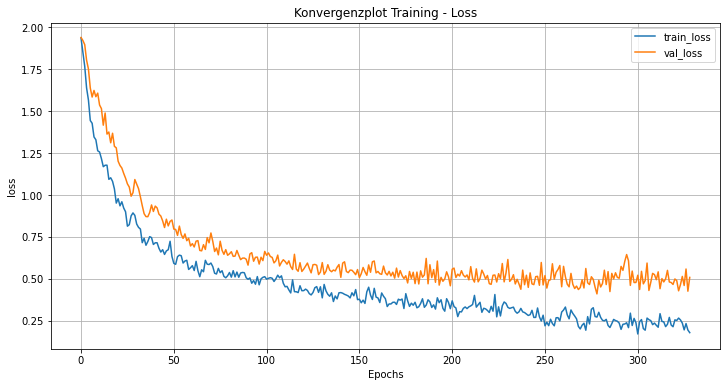

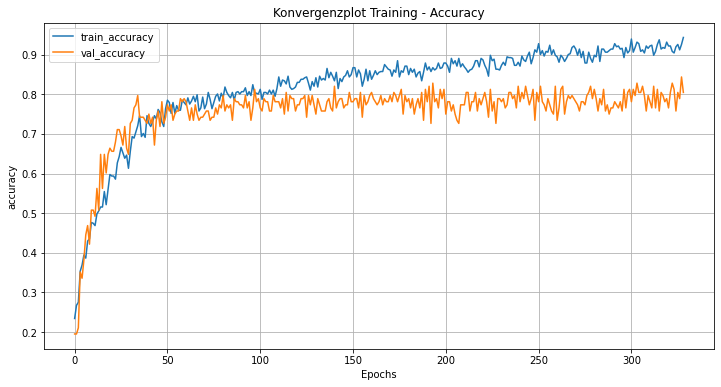

In [48]:
# loss
plt.close()
fig = plt.figure(figsize=(12, 6))
plt.plot(hist.history["loss"], label="train_loss")
plt.plot(hist.history["val_loss"], label="val_loss")
plt.title("Konvergenzplot Training - Loss")
plt.xlabel("Epochs")
plt.ylabel("loss")
plt.grid()
plt.legend()
plt.show()

# accuracy
plt.close()
fig = plt.figure(figsize=(12, 6))
plt.plot(hist.history["accuracy"], label="train_accuracy")
plt.plot(hist.history["val_accuracy"], label="val_accuracy")
plt.title("Konvergenzplot Training - Accuracy")
plt.xlabel("Epochs")
plt.ylabel("accuracy")
plt.grid()
plt.legend()
plt.show()

#### save/load Model

In [57]:
model.save("model/cnn_model_080.tsf")

In [58]:
model = load_model("model/cnn_model_080.tsf")

## Evaluation

In [65]:
# get predictions

preds_val = model.predict(imgs_val, batch_size=16)

print(
    "preds_val Shape=%s, min=%.3f, max=%.3f\n"
    % (preds_val.shape, preds_val.min(), preds_val.max())
)
print(f"{preds_val[0]}\n")
print(f"{get_class_from_id(preds_val[0].argmax())}")

preds_val = preds_val.argmax(axis=-1)

preds_val Shape=(128, 7), min=0.000, max=1.000

[9.5053405e-09 5.8276483e-12 4.8103144e-09 2.6136036e-06 5.4787716e-07
 5.1061527e-11 9.9999678e-01]

sonnenblume


In [59]:
from sklearn import metrics

accuracy = metrics.accuracy_score(labels_val.argmax(axis=-1), preds_val)

accuracy

0.8046875

In [60]:
from sklearn.metrics import classification_report

print(
    classification_report(
        labels_val.argmax(axis=-1), preds_val, target_names=class_names
    )
)

                  precision    recall  f1-score   support

 gaensebluemchen       0.86      1.00      0.92        18
 hasengloeckchen       0.92      0.73      0.81        15
          krokus       0.73      0.80      0.76        10
      loewenzahn       0.85      0.44      0.58        25
        narzisse       0.50      0.88      0.64        16
schneegloeckchen       0.90      0.86      0.88        21
     sonnenblume       1.00      1.00      1.00        23

        accuracy                           0.80       128
       macro avg       0.82      0.82      0.80       128
    weighted avg       0.84      0.80      0.80       128



In [56]:
counter_true = 0
counter_false = 0

for label_val, pred_val in zip(labels_val, preds_val):
    label_class = label_val.argmax(axis=-1)
    pred_class = pred_val
    if label_class == pred_class:
        counter_true += 1
    else:
        counter_false += 1

print(f"counter_true: {counter_true}")
print(f"counter_false: {counter_false}")
print(f"ratio: {round((counter_true/(counter_true + counter_false)),4)}")

counter_true: 103
counter_false: 25
ratio: 0.8047


#### random visio

<Figure size 432x288 with 0 Axes>

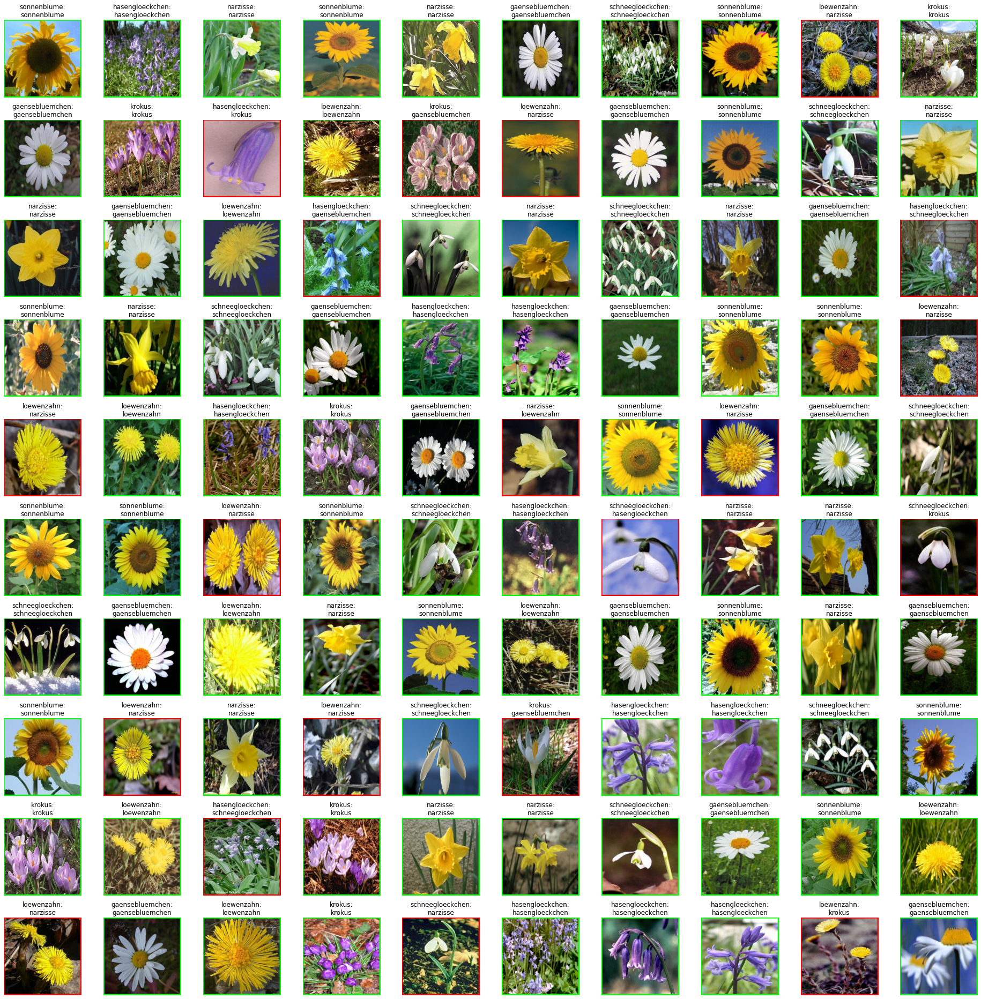

In [53]:
# shuffle images and image targets, with same seed so both are shuffled the same way
np.random.seed(42)
np.random.shuffle(imgs_val)
np.random.seed(42)
np.random.shuffle(labels_val)
np.random.seed(42)
np.random.shuffle(preds_val)


plt.close()
plt.clf()
fig = plt.figure(figsize=(26, 26))
for idx in range(100):
    class_label_tmp = get_class_from_id(np.argmax(labels_val[idx]))
    class_pred_tmp = get_class_from_id(preds_val[idx])
    ax1 = plt.subplot(10, 10, idx + 1)
    plt.title(f"{class_label_tmp}:\n{class_pred_tmp}")
    # draw rectangle
    img_tmp = (imgs_val[idx] * 255).astype("uint8")
    thickness = 8
    if np.argmax(labels_val[idx]) == preds_val[idx]:
        COLOR = (0, 255, 0)
    else:
        COLOR = (255, 0, 0)
    img_tmp = cv2.rectangle(
        img_tmp,
        (1, 1),
        (
            img_size[0] + int(thickness / 2) - thickness,
            img_size[1] + int(thickness / 2) - thickness,
        ),
        COLOR,
        thickness,
    )
    plt.imshow(img_tmp, "gray")
    ax1.axis("off")
plt.tight_layout()
plt.show()

#### fail visio

128it [00:00, 124103.31it/s]
/soft/conda-env/envs/jupyter_ml/lib/python3.7/site-packages/ipykernel_launcher.py:29: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.


Number fo Fail Classifications: 25


<Figure size 432x288 with 0 Axes>

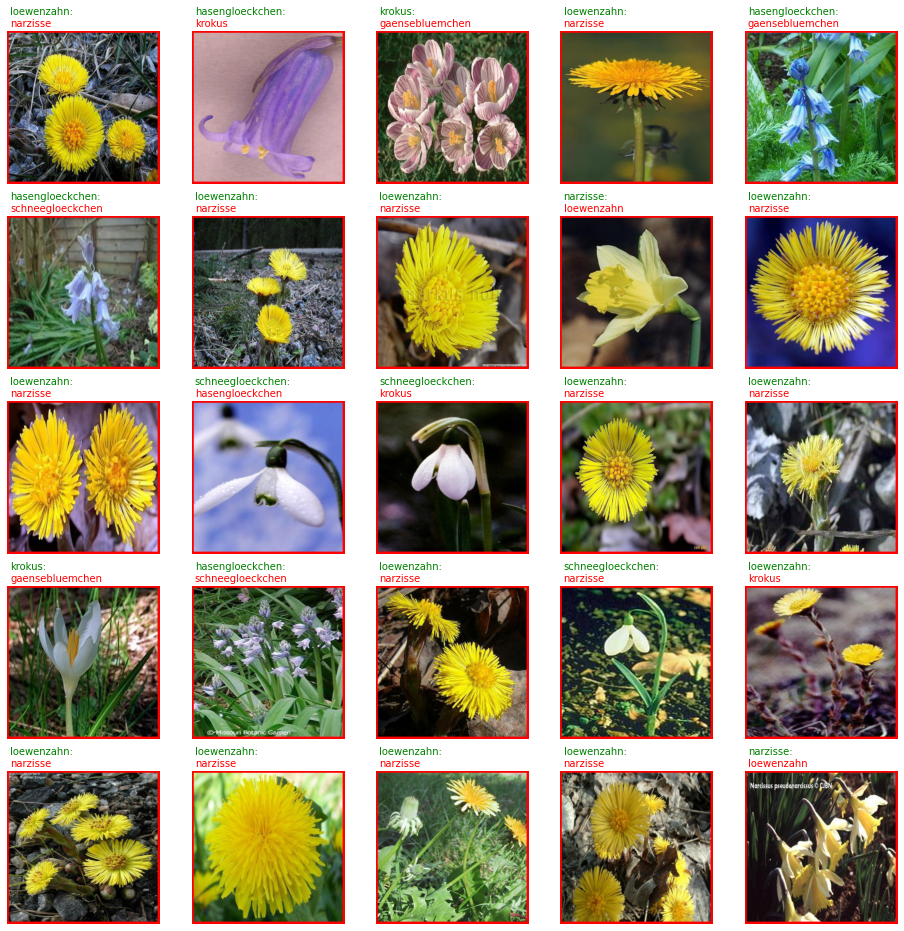

In [101]:
fail_imgs_list = []
fail_labels_list = []
fail_preds_list = []

for img_tmp, label_tmp, pred_tmp in tqdm(zip(imgs_val, labels_val, preds_val)):
    class_label_tmp = np.argmax(label_tmp)
    class_pred_tmp = pred_tmp  # is already a class id
    if class_label_tmp != class_pred_tmp:
        fail_imgs_list.append(img_tmp)
        fail_labels_list.append(class_label_tmp)
        fail_preds_list.append(class_pred_tmp)

print(f"Number fo Fail Classifications: {len(fail_imgs_list)}")

num_row = num_column = np.ceil(np.sqrt(len(fail_imgs_list)))
idx = 0

plt.close()
plt.clf()
fig = plt.figure(figsize=(2.6 * num_row, 2.6 * num_column))

for img_tmp, label_tmp, pred_tmp in zip(
    fail_imgs_list, fail_labels_list, fail_preds_list
):

    class_label_tmp = get_class_from_id(label_tmp)
    class_pred_tmp = get_class_from_id(pred_tmp)

    ax1 = plt.subplot(num_row, num_column, idx + 1)

    plt.text(
        10,
        -50,
        f"{class_label_tmp}:",
        ha="left",
        va="bottom",
        size="medium",
        color="green",
    )
    plt.text(
        10,
        -10,
        f"{class_pred_tmp}",
        ha="left",
        va="bottom",
        size="medium",
        color="red",
    )
    
    # draw rectangle
    img_tmp = (img_tmp * 255).astype("uint8")
    thickness = 8
    img_tmp = cv2.rectangle(
        img_tmp,
        (1, 1),
        (
            img_size[0] + int(thickness / 2) - thickness,
            img_size[1] + int(thickness / 2) - thickness,
        ),
        (255, 0, 0),
        thickness,
    )
    plt.imshow(img_tmp)
    ax1.axis("off")

    idx += 1

plt.tight_layout()
plt.show()